# Simple Spread Trading

Jack Mansfield

## Intro
My ETF pair was: IDU (iShares US Utilities ETF) and XLU (Utilities Select Sector SPDR Fund). These two ETFs are ideal for spread trading because they both track the stable utilities sector and exhibit strong historical correlation. Their similar market movements often diverge slightly, creating profitable opportunities. By exploiting these price differences, my strategy aims to generate consistent returns, leveraging the nuanced differences between these closely linked ETFs.

# Import dependencies and init globals

In [55]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import pandas as pd
import numpy as np
import scipy as sp
import math
import quandl
import functools
import seaborn as sns

import os
from datetime import datetime
from datetime import datetime
from dateutil.relativedelta import relativedelta

import statsmodels.api as sm


import backtrader as bt

from enum import Enum

class States(Enum):
    NEUTRAL = 0
    LONG_X_SHORT_Y = 1
    LONG_Y_SHORT_X = 2

class Actions(Enum):
    NEUTRAL = 0
    OPENING = 1
    SWITCH_POSITION_REVERTING = 2
    CLOSING = 3


# Startdate, enddate place holders
start_date = pd.to_datetime("2021-12-02")
end_date = pd.to_datetime("2023-11-15")


# Helper Funcitons

In [56]:
def grab_quandl_table(
    table_path,
    avoid_download=False,
    replace_existing=False,
    date_override=None,
    allow_old_file=False,
    **kwargs,
):
    root_data_dir = os.path.join(r"C:\Users\jackm\OneDrive\Desktop\MSFM\QTS\HW2\Spread-Trading", "quandl_data_table_downloads")
    data_symlink = os.path.join(root_data_dir, f"{table_path}_latest.zip")
    if avoid_download and os.path.exists(data_symlink):
        print(f"Skipping any possible download of {table_path}")
        return data_symlink
    
    table_dir = os.path.dirname(data_symlink)
    if not os.path.isdir(table_dir):
        print(f'Creating new data dir {table_dir}')
        os.mkdir(table_dir)

    if date_override is None:
        my_date = datetime.now().strftime("%Y%m%d")
    else:
        my_date = date_override
    data_file = os.path.join(root_data_dir, f"{table_path}_{my_date}.zip")

    if os.path.exists(data_file):
        file_size = os.stat(data_file).st_size
        if replace_existing or not file_size > 0:
            print(f"Removing old file {data_file} size {file_size}")
        else:
            print(
                f"Data file {data_file} size {file_size} exists already, no need to download"
            )
            return data_file

    dl = quandl.export_table(
        table_path, filename=data_file, api_key='YOUR API KEY HERE', **kwargs
    )
    file_size = os.stat(data_file).st_size
    if os.path.exists(data_file) and file_size > 0:
        print(f"Download finished: {file_size} bytes")
        if not date_override:
            if os.path.exists(data_symlink):
                print(f"Removing old symlink")
                os.unlink(data_symlink)
            print(f"Creating symlink: {data_file} -> {data_symlink}")
            os.symlink(
                data_file, data_symlink,
            )
    else:
        print(f"Data file {data_file} failed download")
        return
    return data_symlink if (date_override is None or allow_old_file) else "NoFileAvailable"


def fetch_quandl_table(table_path, avoid_download=True, **kwargs):
    return pd.read_csv(
        grab_quandl_table(table_path, avoid_download=avoid_download, **kwargs)
    )

# Fetching Historical data from Quandl

In [57]:
prices = fetch_quandl_table('QUOTEMEDIA/PRICES', avoid_download=True)

Skipping any possible download of QUOTEMEDIA/PRICES


In [58]:
display(prices.head())

,ticker,date,open,high,low,close,volume,dividend,split,adj_open,adj_high,adj_low,adj_close,adj_volume
0,JTKWY,2022-03-11,6.1700,7.3200,5.790,6.72,9440097.0,0.0,1.0,6.1700,7.3200,5.790,6.72,9440097.0
1,JTKWY,2022-03-10,6.1600,6.1750,5.935,6.07,2261623.0,0.0,1.0,6.1600,6.1750,5.935,6.07,2261623.0
2,FG_1,2020-06-01,8.1000,8.3900,8.100,8.39,3086317.0,0.0,1.0,8.1000,8.3900,8.100,8.39,3086317.0
3,FLWS,2022-03-09,14.5700,14.9588,14.410,14.45,662492.0,0.0,1.0,14.5700,14.9588,14.410,14.45,662492.0
4,RENW_,2020-01-29,21.9768,21.9900,21.970,21.99,319.0,0.0,1.0,21.9768,21.9900,21.970,21.99,319.0


Filter to only relevant dates

In [59]:
# Convert date column into a datetime object, and set it to the index
prices['date'] = pd.to_datetime(prices['date'])

# Filter to only Relevant Dates
SVOL_data = prices[(prices['ticker'] == 'SVOL') & (prices['date']>=start_date) & (prices['date'] <= end_date) ]
x_data = prices[(prices['ticker'] == 'IDU') & (prices['date']>=start_date) & (prices['date'] <= end_date) ]
y_data = prices[(prices['ticker'] == 'XLU') & (prices['date']>=start_date) & (prices['date'] <= end_date) ]

display(SVOL_data.head())
display(x_data.head())
display(y_data.head())

,ticker,date,open,high,low,close,volume,dividend,split,adj_open,adj_high,adj_low,adj_close,adj_volume
987554,SVOL,2023-06-05,22.55,22.5200,22.455,22.49,412983.0,0.00,1.0,22.55,22.5200,22.455,22.49,412983.0
1413184,SVOL,2023-04-11,22.01,22.0796,21.980,22.06,142574.0,0.00,1.0,22.01,22.0796,21.980,22.06,142574.0
1655711,SVOL,2023-01-25,22.88,22.9000,22.565,22.90,128840.0,0.00,1.0,22.88,22.9000,22.565,22.90,128840.0
1793101,SVOL,2022-08-29,22.42,22.5100,22.290,22.51,94932.0,0.00,1.0,22.42,22.5100,22.290,22.51,94932.0
1793102,SVOL,2022-08-26,23.17,23.2900,22.420,22.42,84325.0,0.32,1.0,23.17,23.2900,22.420,22.42,84325.0


,ticker,date,open,high,low,close,volume,dividend,split,adj_open,adj_high,adj_low,adj_close,adj_volume
4099808,IDU,2023-07-31,83.52,83.81,82.97,83.28,42660.0,0.0,1.0,82.153933,82.439190,81.612929,81.917858,42660.0
5029732,IDU,2023-08-25,78.41,79.28,78.41,78.92,72230.0,0.0,1.0,77.127513,77.983283,77.127513,77.629171,72230.0
11576189,IDU,2023-08-09,80.12,80.90,79.88,80.30,124313.0,0.0,1.0,78.809544,79.576786,78.573469,78.986600,124313.0
16798508,IDU,2023-06-12,81.81,81.91,81.44,81.78,22440.0,0.0,1.0,80.471902,80.570266,80.107954,80.442393,22440.0
24717272,IDU,2023-11-13,75.52,75.65,74.84,74.90,40562.0,0.0,1.0,74.932053,75.061040,74.257347,74.316879,40562.0


,ticker,date,open,high,low,close,volume,dividend,split,adj_open,adj_high,adj_low,adj_close,adj_volume
5030190,XLU,2023-10-19,59.04,59.590,58.5950,58.64,19681161.0,0.0,1.0,58.487615,59.032469,58.046779,58.091358,19681161.0
5219572,XLU,2022-11-11,68.85,69.030,67.4339,68.08,15312009.0,0.0,1.0,67.111795,67.287250,65.731446,66.361234,15312009.0
6905331,XLU,2023-10-04,57.13,57.241,55.8900,56.78,29496121.0,0.0,1.0,56.595485,56.705447,55.367087,56.248760,29496121.0
8811604,XLU,2023-01-09,70.99,72.020,70.7800,71.48,11718493.0,0.0,1.0,69.197768,70.201764,68.993069,69.675397,11718493.0
9200323,XLU,2023-09-22,63.13,63.705,62.8700,63.29,12297659.0,0.0,1.0,62.539349,63.108969,62.281781,62.697852,12297659.0


# Data Processing

In [60]:
# Data structure enabling quick acess to the raw dataset for each of the futures
ETFS = {
    'SVOL': SVOL_data.copy(),
    'IDU': x_data.copy(),
    'XLU': y_data.copy()
}

M = 15

# Iterate through each of the data sets and filter down to just the values we want
for key,value in ETFS.items():
    # Convert set date column to the index
    value.set_index(value['date'],inplace=True)
    
    # Drop the date column so there are no duplicate columns
    value.drop('date', axis=1, inplace=True)

    # Drop Dividend and split columns since we dont use them
    value.drop('dividend', axis=1, inplace=True)
    value.drop('split', axis=1, inplace=True)

    # Set raw OHLCV to their Adjusted values, enabling all backtrader fucntions to work with adjusted values
    value['open'] = value['adj_open']
    value['high'] = value['adj_high']
    value['low'] = value['adj_low']
    value['close'] = value['adj_close']
    value['volume'] = value['adj_volume']

    # Drop the adjusted values from the table and remeber that the OHLCV values we will be working with moving forward are the adjusted values. 
    value = value.drop(['adj_open', 'adj_high', 'adj_low', 'adj_close', 'adj_volume'], axis=1)

    # sort data frame by date
    value.sort_index(inplace=True)

    # Calulate the daily dollar volume
    value['Daily_Dol_Vol'] = value["close"] * value['volume']
    
    # Calulate the median daily dollar volume over the past 15 periods
    rolling_window = value['Daily_Dol_Vol'].rolling(window=15)
    value['Median_Daily_Dol_Vol'] = rolling_window.median()

    # Calculate the 15-day return
    value['15_day_return'] = ((value['close'] ) / value['close'].shift(15) ) - 1.0

    # Calculate the 20-day return
    value['20_day_return'] = ((value['close'] ) / value['close'].shift(20) ) - 1.0
    
    # Calculate the 25-day return
    value['25_day_return'] = ((value['close'] ) / value['close'].shift(25) ) - 1.0

    ETFS[key] = value

# Calulate the 15 day spread
z = (ETFS['IDU']['15_day_return'] - ETFS['XLU']['15_day_return']).to_frame()
z.fillna(0.00, inplace=True)
z.replace([np.inf, -np.inf], 0, inplace=True)

ETFS['IDU']['z_15'] = z['15_day_return']
ETFS['XLU']['z_15'] = z['15_day_return']

# Calulate the 20 day spread
z = (ETFS['IDU']['20_day_return'] - ETFS['XLU']['20_day_return']).to_frame()
z.fillna(0.00, inplace=True)
z.replace([np.inf, -np.inf], 0, inplace=True)

ETFS['IDU']['z_20'] = z['20_day_return']
ETFS['XLU']['z_20'] = z['20_day_return']

# Calulate the 25 day spread
z = (ETFS['IDU']['25_day_return'] - ETFS['XLU']['25_day_return']).to_frame()
z.fillna(0.00, inplace=True)
z.replace([np.inf, -np.inf], 0, inplace=True)

ETFS['IDU']['z_25'] = z['25_day_return']
ETFS['XLU']['z_25'] = z['25_day_return']


# Calulate N_t defined as the minimum 15 day rolling median of daily dollar volume between the 2 ETFs
n = np.minimum(ETFS['IDU']['Median_Daily_Dol_Vol'], ETFS['XLU']['Median_Daily_Dol_Vol'] )
n.fillna(0.00, inplace=True)

ETFS['IDU']['n_t'] = n
ETFS['XLU']['n_t'] = n


display(ETFS['IDU'].tail())
display(ETFS['XLU'].tail())



,ticker,open,high,low,close,volume,Daily_Dol_Vol,Median_Daily_Dol_Vol,15_day_return,20_day_return,25_day_return,z_15,z_20,z_25,n_t
date,,,,,,,,,,,,,,,
2023-11-09,IDU,75.676214,75.864734,74.698882,74.741944,49204.0,3.677603e+06,5.168324e+06,0.027532,0.028774,0.064040,0.004340,0.005582,0.001153,5.168324e+06
2023-11-10,IDU,74.981663,75.080885,74.644310,75.051614,44249.0,3.320959e+06,5.168324e+06,0.043030,0.021893,0.055253,0.003567,0.004692,0.001628,5.168324e+06
2023-11-13,IDU,74.932053,75.061040,74.257347,74.316879,40562.0,3.014441e+06,5.120340e+06,0.040567,0.001069,0.034816,0.004766,0.006244,0.004031,5.120340e+06
2023-11-14,IDU,75.586914,77.095081,75.586914,77.035548,104323.0,8.036579e+06,5.120340e+06,0.054748,0.038662,0.059064,0.004596,0.001340,0.001566,5.120340e+06
2023-11-15,IDU,76.966093,77.789631,76.737883,76.827183,64552.0,4.959348e+06,4.959348e+06,0.043250,0.045787,0.041566,0.002138,0.002566,0.004125,4.959348e+06


,ticker,open,high,low,close,volume,Daily_Dol_Vol,Median_Daily_Dol_Vol,15_day_return,20_day_return,25_day_return,z_15,z_20,z_25,n_t
date,,,,,,,,,,,,,,,
2023-11-09,XLU,60.340119,60.528342,59.408914,59.438633,16097520.0,9.568146e+08,1.178183e+09,0.023192,0.023192,0.062888,0.004340,0.005582,0.001153,5.168324e+06
2023-11-10,XLU,59.706107,59.924049,59.359382,59.755640,14015090.0,8.374807e+08,1.178183e+09,0.039462,0.017201,0.053624,0.003567,0.004692,0.001628,5.168324e+06
2023-11-13,XLU,59.626856,59.765546,58.951930,59.042376,15579238.0,9.198352e+08,1.178183e+09,0.035801,-0.005174,0.030785,0.004766,0.006244,0.004031,5.120340e+06
2023-11-14,XLU,60.369839,61.449641,60.246008,61.400108,28658779.0,1.759652e+09,1.178183e+09,0.050152,0.037322,0.057499,0.004596,0.001340,0.001566,5.120340e+06
2023-11-15,XLU,61.231699,62.103466,61.073196,61.211886,24831116.0,1.519959e+09,1.178183e+09,0.041112,0.043221,0.037441,0.002138,0.002566,0.004125,4.959348e+06


# Helper Classes

In [61]:
# Extend PandasData to include additional columns
class ExtendedPandasData(bt.feeds.PandasData):
    # Add a 'lines' definition for each extra column
    lines = ('Daily_Dol_Vol', 'Median_Daily_Dol_Vol','price_M_days_ago','M_day_return','z_15', 'z_20','z_25', 'n_t')#'daily_returns', 'M_day_cum_return')
    
    # Add the corresponding parameters
    params = (
        ('Daily_Dol_Vol', -1),
        ('Median_Daily_Dol_Vol', -1),
        ('price_M_days_ago', -1),
        ('M_day_return', -1),
        ('z_15', -1),
        ('z_20', -1),
        ('z_25', -1),
        ('n_t', -1)
    )

# Analyzer allowng us to track the cumulative PnL
class CumulativePNL(bt.Analyzer):
    def __init__(self):
        self.pnl = []

    def next(self):
        # Assuming self.strategy.broker.getvalue() gives the portfolio value
        self.pnl.append(self.strategy.broker.getvalue() - self.strategy.broker.startingcash)

    def get_analysis(self):
        return self.pnl

# The Strategy

In [62]:

class SpreadReversionStrategy(bt.Strategy):
    # Strategy parameters
    params = (
        ('M', 15),  # M-day return period
        ('g', 0.003),  # Entry threshold
        ('j', 0.001),  # Exit threshold
        ('s', 0.1),  # Stop loss threshold
        ('zeta', 0.0001),  # Trading cost
        ('backtest_start_date', datetime(2022, 1, 1).date()),
        ('backtest_end_date', datetime(2023, 11, 15).date()),
    )

    # Custom strategy lines
    lines = ('cumulative_pnl', 'unrealized_pnl', 'gross_traded_cash')

    def __init__(self):
        # Data retrieval and initializations
        self.x_data = self.getdatabyname('X')  # Retrieve 'X' data
        self.y_data = self.getdatabyname('Y')  # Retrieve 'Y' data
        self.x_dict = {}  # Store 'X' data in a dictionary
        self.y_dict = {}  # Store 'Y' data in a dictionary

        # Tracking statistics
        self.gross_traded_cash = 0  # Total gross traded cash
        self.positonal_gross_traded_cash = 0  # Positional gross traded cash

        # Helper variables
        self.STATUS = 0  # Current status of the strategy
        self.ACTION = 0  # Last action taken by the strategy
        self.starting_STATUS = 0  # Starting status of the current period
        self.order = None  # Current order
        self.entry_price = 0  # Entry price for the current trade
        self.counter = 0  # Counter for iteration
        self.stop_loss_penalty_end_date = self.params.backtest_start_date  # Stop loss penalty end date

        # Data storage for plotting
        self.data_dict = []

    def next(self):
        # Create a Dict to store all 'X' data from this period
        self.x_data = self.getdatabyname('X')
        self.x_dict = {
            'Date': self.x_data.datetime.date(0),
            'Open': self.x_data.open[0],
            'High': self.x_data.high[0],
            'Low': self.x_data.low[0],
            'Close': self.x_data.close[0],
            'Volume': self.x_data.volume[0],
            'Daily_Dol_Vol': self.x_data.Daily_Dol_Vol[0],
            'Median_Daily_Dol_Vol': self.x_data.Median_Daily_Dol_Vol[0],
            'price_M_days_ago' : self.x_data.price_M_days_ago[0],
            'M_day_return' : self.x_data.M_day_return[0],
            'z_15': self.x_data.z_15[0],
            'z_20': self.x_data.z_20[0],
            'z_25': self.x_data.z_25[0],
            'n_t': self.x_data.n_t[0],
        }

        # Create a Dict to store all 'Y' data from this period
        self.y_data = self.getdatabyname('Y')
        self.y_dict = {
            'Date': self.y_data.datetime.date(0),
            'Open': self.y_data.open[0],
            'High': self.y_data.high[0],
            'Low': self.y_data.low[0],
            'Close': self.y_data.close[0],
            'Volume': self.y_data.volume[0],
            'Daily_Dol_Vol': self.y_data.Daily_Dol_Vol[0],
            'Median_Daily_Dol_Vol': self.y_data.Median_Daily_Dol_Vol[0],
            'price_M_days_ago' : self.y_data.price_M_days_ago[0],
            'M_day_return' : self.y_data.M_day_return[0],
            'z_15': self.y_data.z_15[0],
            'z_20': self.y_data.z_20[0],
            'z_25': self.y_data.z_25[0],
            'n_t': self.y_data.n_t[0],
        }

        # Print statements to ensure data feed was set up properly
        if self.counter < 0:
            display(self.return_x[0])
            display(self.return_y[0])
            display(pd.DataFrame([self.x_dict], index=['X']))
            display(pd.DataFrame([self.y_dict], index=['Y']))
        
        # Skip dates outside the backtesting period
        current_date = self.datas[0].datetime.date(0)
        if (current_date < self.params.backtest_start_date or 
            current_date > self.params.backtest_end_date or 
            current_date < self.stop_loss_penalty_end_date):
            return
        
        # Close position at the end of the analysis period
        if current_date == self.params.backtest_end_date:
            self.close_spread_position()
            return

        # Update cumulative PnL
        self.lines.cumulative_pnl[0] = self.broker.getvalue() - self.broker.startingcash

        # Update unrealized PnL
        total_unrealized_pnl = 0
        for data in self.datas: # Iterate through all postions
            position = self.getposition(data)
            if position.size:
                pnl = (data.close[0] - position.price) * position.size
                total_unrealized_pnl += pnl # Sum Each positons PNL
        self.lines.unrealized_pnl[0] = total_unrealized_pnl
        
        # Update gross_traded_cash
        self.lines.gross_traded_cash[0] = self.gross_traded_cash

        # calulate z for this period
        if self.params.M == 15:
            z = self.x_dict['z_15']# Difference in M-day return
        elif self.params.M == 20:
            z = self.x_dict['z_20']# Difference in M-day return
        elif self.params.M == 25:
            z = self.x_dict['z_25']# Difference in M-day return
        else:
            raise Exception(f"ERROR M IS OUT OF BOUNDS{self.params.M}")

        # retrieve N_t for this period
        N_t = self.x_dict['n_t']

        # Set Starting Status
        self.starting_STATUS = self.STATUS

        print(f"--------------------{self.counter}-------------------------")
        
        print(f"Starting Status: {self.STATUS}")
        print(f'z: {z}')
        print(f'g: {self.params.g}')
        print(f'j: {self.params.j}')
        print(f"Date: {self.datas[0].datetime.date(0)}, "
              f"Cumulative PnL: {self.lines.cumulative_pnl[0]}, "
              f"Unrealized PnL: {self.lines.unrealized_pnl[0]}, "
              f"Gross Traded Cash: {self.lines.gross_traded_cash[0]}")
        
        # CHECK STOP LOSS
        if self.STATUS != 0: # If we have a position
            if self.lines.unrealized_pnl[0] <= -1*(self.params.s*self.positonal_gross_traded_cash): # if loses on this postion are too great
                # close positons
                self.close_spread_position()

                # dont trade until a month from the current date
                self.stop_loss_penalty_end_date = current_date + relativedelta(months=1)

        # Trading Logic
        self.ACTION = 0 
        if abs(z) >= self.params.g:
            if self.STATUS == 1 or self.STATUS == 2: #self.order: # If we have a position
                 # if current postition is out of line with the signal
                if ((self.getposition(self.x_data).size > 0 and z > 0) or
                    (self.getposition(self.x_data).size < 0 and z < 0)):
                    
                    print('current_position is out of line with signal')
                    self.close_spread_position()
                    self.enter_spread_position(z, N_t)
                    self.ACTION = 3

                else: # position is in line with the signal
                    print('current_position is in line with signal')
                    self.ACTION = 0
                    pass # do nothing

            elif self.STATUS == 0: #If we do not have a position
                print("both x and y postions are NONE")
                print("enter_spread_position")
                self.enter_spread_position(z, N_t)
                self.ACTION = 1 
            else:
                raise Exception("ERROR: STATUS ISNT AN ENUM VALUE (0,1,2)")

            
        elif abs(z) <= self.params.j: # If spread less than j 
            if self.getposition(self.x_data) and self.getposition(self.y_data): # If we have a position
                print("closing postions")
                self.close_spread_position() # Close Postions
                self.ACTION = 2
            elif not (self.getposition(self.x_data)) and not(self.getposition(self.y_data)): # we dont have a position
                self.ACTION = 0 # Do nothing
                pass 
            else:
                raise Exception("ERROR: we are holding 1/2 positions line 127")
       
        # Save data each bar for later ploting
        self.data_dict.append({
            'date': current_date,
            'X_close': self.x_dict['Close'],
            'Y_close': self.y_dict['Close'],
            'z' : z,
            'N_t': N_t,
            "Cumulative PnL" : self.lines.cumulative_pnl[0], 
            "Unrealized PnL": self.lines.unrealized_pnl[0], 
            "Gross Traded Cash": self.lines.gross_traded_cash[0],
            "starting_status": self.starting_STATUS,
            "ending_status" : self.STATUS,
            "Action": self.ACTION
            # Add other data points as needed, like indicators, cash, portfolio value, etc.
        })

        self.counter += 1
        print()
        return

    def enter_spread_position(self, z, N_t):
        if self.STATUS != 0:
            return
        
        # Calc Trade quantities
        trade_amt = N_t/100.00
        num_x = int( trade_amt / self.x_dict['Close'])
        num_y = int( trade_amt / self.y_dict['Close'])

        if (z > 0): # If recent return of X is larger
            self.order = self.sell(data=self.getdatabyname('X'), size=num_x) # Short X
            self.order = self.buy(data=self.getdatabyname('Y'), size=num_y)  # Long Y
            self.STATUS = 1
        elif(z < 0): # If recent return of Y is larger
            self.order = self.buy(data=self.getdatabyname('X'), size=num_x)  # Long X
            self.order = self.sell(data=self.getdatabyname('Y'), size=num_y) # Short Y
            self.STATUS = 2
        else:
            raise Exception("ERROR z > g But z == 0")
        
        self.positonal_gross_traded_cash = abs(num_x*self.x_dict['Close']) + abs(num_y * self.y_dict['Close'])
        return

    def close_spread_position(self):
        # Close position
        self.close(data=self.x_data)
        self.close(data=self.y_data)
        # Set satus
        self.STATUS = 0
        #reset positonal_gross_traded_cash
        self.positonal_gross_traded_cash = 0
        
    # Prints when we place new trades
    def notify_trade(self, trade):
        if trade.justopened:
            self.current_trade = trade
            print("New trade opened")
        elif trade.isclosed:
            print("Trade closed")
            self.current_trade = None
        print(f"Size: {trade.size}")
        print(f"Price: {trade.price}")
        print(f"Value: {trade.value}")
        print(f"Profit/Loss: {trade.pnl}")
        print(f"Net Profit/Loss: {trade.pnlcomm}")
        print()
    
    # Prints when our order is filled
    def notify_order(self, order):
        # Update gross traded cash on order completion
        if order.status in [order.Completed]:
            # Calc Cash traded for this transaction
            traded_cash = abs(order.executed.size) * order.executed.price

            # Pentalize Broker for trading cost
            cost = self.params.zeta * traded_cash
            self.broker.add_cash(-cost)

            # Update gross_traded_cash
            self.gross_traded_cash += traded_cash
            self.lines.gross_traded_cash[0] = self.gross_traded_cash

            # Print order execution details
            print(f"Order Executed: Size = {order.executed.size}, "
                  f"Price = {order.executed.price}, "
                  f"Value = {order.executed.size * order.executed.price}, "
                  f"Current Gross Traded Cash: {self.gross_traded_cash}")


# Inital Run of the Strategy

In [63]:
# Create a cerebro instance
cerebro = bt.Cerebro()

# Convert Pandas DataFrames to Backtrader Data Feeds
data_idu = ExtendedPandasData(dataname=ETFS['IDU'])
data_xlu = ExtendedPandasData(dataname=ETFS['XLU'])

# Add data feeds to Cerebro
Data_x = cerebro.adddata(data_idu, name='X')
Data_x.plotinfo.plot = False

Data_y = cerebro.adddata(data_xlu, name='Y')
Data_y.plotinfo.plot = False

M = 15        # M-day return period
g = 0.003     # Entry threshold
j = 0.001     # Exit threshold
s = 0.1       # Stop loss threshold
zeta = 0.0001 # Trading cost
K = 2 * (n.max()) # Starting Capital

# Add the strategy
cerebro.addstrategy(SpreadReversionStrategy, M = M, g = g, j = j, s = s, zeta = zeta)

# add analyzer
cerebro.addanalyzer(bt.analyzers.TimeReturn, _name='timereturn')


# Enable Cheat on close which allows immediate execution at the close price
cerebro.broker.set_coc(True)

# Set initial capital
cerebro.broker.set_cash(K)

# Run the strategy
strategies = cerebro.run(maxcpus=1)

--------------------0-------------------------
Starting Status: 0
z: -0.004656694252572979
g: 0.003
j: 0.001
Date: 2022-01-03, Cumulative PnL: 0.0, Unrealized PnL: 0.0, Gross Traded Cash: 0.0
both x and y postions are NONE
enter_spread_position

Order Executed: Size = 417, Price = 84.7257722733168, Value = 35330.64703797311, Current Gross Traded Cash: 35330.64703797311
Order Executed: Size = -523, Price = 67.6385927646604, Value = -35374.98401591739, Current Gross Traded Cash: 70705.63105389051
New trade opened
Size: 417
Price: 84.7257722733168
Value: 35330.64703797311
Profit/Loss: 0.0
Net Profit/Loss: 0.0

New trade opened
Size: -523
Price: 67.6385927646604
Value: -35374.98401591739
Profit/Loss: 0.0
Net Profit/Loss: 0.0

--------------------1-------------------------
Starting Status: 2
z: -0.00033527814570111225
g: 0.003
j: 0.001
Date: 2022-01-04, Cumulative PnL: 77.50400291755795, Unrealized PnL: 77.50400291942125, Gross Traded Cash: 70705.63105389051
closing postions

Order Executed

In [64]:
# Extract data From backtest
first_strategy = strategies[0]
data_list = pd.DataFrame(first_strategy.data_dict)

# Set index of Extracted back testing data to date
data_list['date'] = pd.to_datetime(data_list['date'])
data_list.set_index('date', inplace=True)

display(data_list)

,X_close,Y_close,z,N_t,Cumulative PnL,Unrealized PnL,Gross Traded Cash,starting_status,ending_status,Action
date,,,,,,,,,,
2022-01-03,84.725772,67.638593,-0.004657,3.540990e+06,0.000000,0.000000,0.000000e+00,0,2,1
2022-01-04,84.648291,67.428624,-0.000335,3.540990e+06,77.504003,77.504003,7.070563e+04,2,0,2
2022-01-05,84.280255,67.390448,-0.002722,3.540990e+06,70.433440,0.000000,1.412691e+05,0,0,0
2022-01-06,83.534498,66.693733,-0.000722,3.540990e+06,63.377089,0.000000,1.412691e+05,0,0,0
2022-01-07,84.125292,67.199567,-0.001331,3.540990e+06,63.377089,0.000000,1.412691e+05,0,0,0
...,...,...,...,...,...,...,...,...,...,...
2023-11-08,75.537303,60.231149,0.001723,5.304901e+06,2154.757150,0.000000,7.125922e+06,0,0,0
2023-11-09,74.741944,59.438633,0.004340,5.168324e+06,2154.757150,0.000000,7.125922e+06,0,1,1
2023-11-10,75.051614,59.755640,0.003567,5.168324e+06,2216.253294,61.496144,7.229221e+06,1,1,0


# Plots of Inital Run

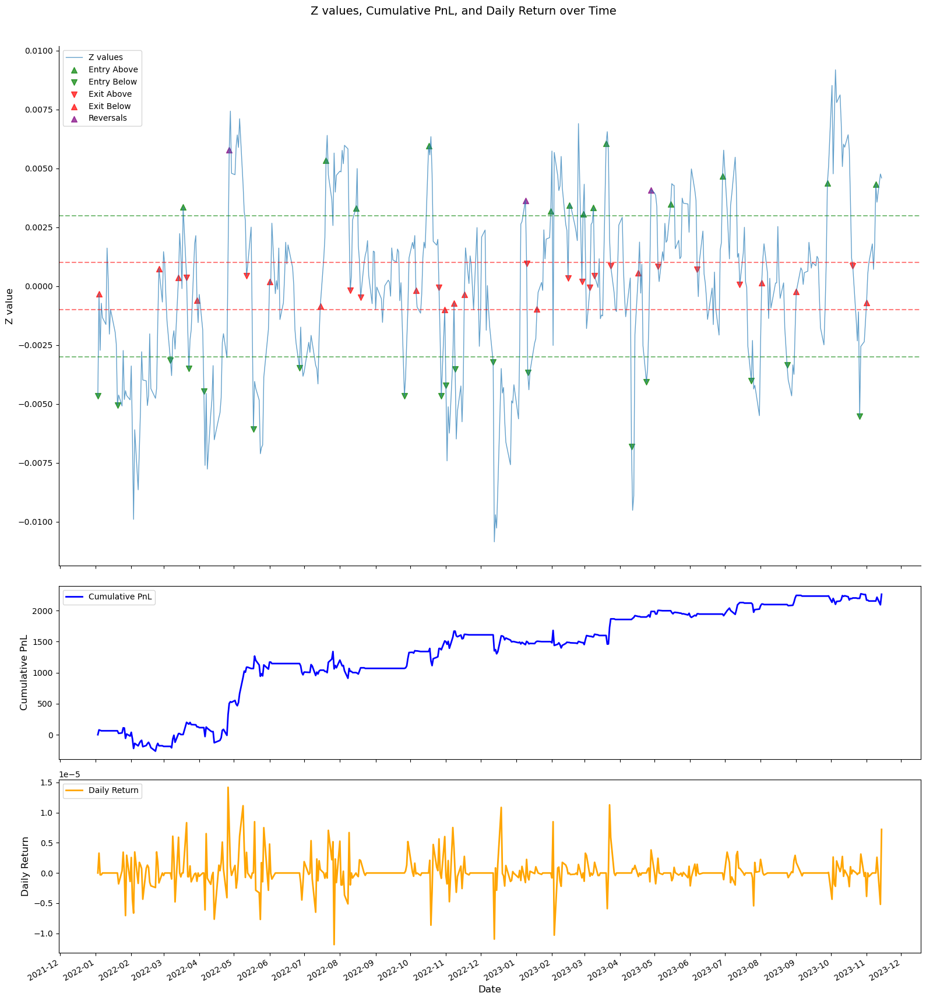

In [65]:

entry_above = data_list[(data_list['Action'] == 1) & (data_list['ending_status'] == 1)].index
entry_below = data_list[(data_list['Action'] == 1) & (data_list['ending_status'] == 2)].index
exit_above = data_list[(data_list['Action'] == 2) & (data_list['starting_status'] == 1)].index
exit_below = data_list[(data_list['Action'] == 2) & (data_list['starting_status'] == 2)].index

status_1 = data_list[(data_list['ending_status'] == 1)].index
status_2 = data_list[ (data_list['ending_status'] == 2)].index
status_3 = data_list[ (data_list['ending_status'] == 3)].index

reverals_high_to_low = data_list[(data_list['starting_status'] == 1) & (data_list['ending_status'] == 2)].index
reverals_low_to_high = data_list[(data_list['starting_status'] == 2) & (data_list['ending_status'] == 1)].index

# Convert Time Return data to a DataFrame for better readability
time_return = first_strategy.analyzers.timereturn.get_analysis()
time_returns_df = pd.DataFrame(list(time_return.items()), columns=['Date', 'Return'])
time_returns_df['Date'] = pd.to_datetime(time_returns_df['Date'])
time_returns_df.set_index('Date', inplace=True)
time_returns_df = time_returns_df[(time_returns_df.index>=pd.to_datetime("2022-01-03")) & (time_returns_df.index<=pd.to_datetime("2023-11-14")) ]


# Create a figure and a set of subplots
fig, axs = plt.subplots(3, 1, figsize=(16, 18), sharex=True, 
                        gridspec_kw={'height_ratios': [3, 1, 1]})

# Plot Z values on the first subplot
axs[0].plot(data_list.index.to_numpy(), data_list['z'].to_numpy(), label='Z values', linewidth=1, alpha=0.7)

# Add horizontal lines with less opacity for Z values
axs[0].axhline(y=0.003, color='g', linestyle='--', alpha=0.5)
axs[0].axhline(y=-0.003, color='g', linestyle='--', alpha=0.5)
axs[0].axhline(y=0.001, color='r', linestyle='--', alpha=0.5)
axs[0].axhline(y=-0.001, color='r', linestyle='--', alpha=0.5)

# Mark entry and exit positions
axs[0].scatter(entry_above, data_list.loc[entry_above, 'z'], marker='^', color='g', s=50, alpha=0.7, label='Entry Above')
axs[0].scatter(entry_below, data_list.loc[entry_below, 'z'], marker='v', color='g', s=50, alpha=0.7, label='Entry Below')
axs[0].scatter(exit_above, data_list.loc[exit_above, 'z'], marker='v', color='r', s=50, alpha=0.7, label='Exit Above')
axs[0].scatter(exit_below, data_list.loc[exit_below, 'z'], marker='^', color='r', s=50, alpha=0.7, label='Exit Below')
axs[0].scatter(reverals_low_to_high, data_list.loc[reverals_low_to_high, 'z'], marker='^', color='purple', s=50, alpha=0.7, label='Reversals')


# Set labels for the first subplot
axs[0].set_ylabel('Z value', fontsize=12)
axs[0].legend(loc='upper left')
axs[0].spines['top'].set_visible(False)
axs[0].spines['right'].set_visible(False)

# Plot Cumulative PnL on the second subplot
axs[1].plot(data_list.index.to_numpy(), data_list['Cumulative PnL'].to_numpy(), label='Cumulative PnL', color='blue', linewidth=2)
axs[1].set_xlabel('Date', fontsize=12)
axs[1].set_ylabel('Cumulative PnL', fontsize=12)
axs[1].legend(loc='upper left')

# Third subplot for Time Return
axs[2].plot(time_returns_df.index.to_numpy(), time_returns_df['Return'].to_numpy(), label='Daily Return', color='orange', linewidth=2)
axs[2].set_xlabel('Date', fontsize=12)
axs[2].set_ylabel('Daily Return', fontsize=12)
axs[2].legend(loc='upper left')

# Set the x-axis to display dates in a readable format for all subplots
axs[2].xaxis.set_major_locator(mdates.MonthLocator(interval=1))
axs[2].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))

# Rotate and align the tick labels so they look better
fig.autofmt_xdate()

# Set the title for the entire figure
fig.suptitle('Z values, Cumulative PnL, and Daily Return over Time', fontsize=14)

# Adjust the space between the subplots
plt.subplots_adjust(hspace=0.3)

# Show the plot with a tight layout
plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust the rectangle inscribed by the subplots
plt.show()


# Hyper-Parameter Optimization

I decided to use simple grid search for my hyper parameter optimization. I set a range of values for each parameter and let backtraders optimization software calulate the best set of parameters based on Cumulative PnL.

In [66]:
# Create a cerebro instance
cerebro = bt.Cerebro()

# Convert Pandas DataFrames to Backtrader Data Feeds
data_idu = ExtendedPandasData(dataname=ETFS['IDU'])
data_xlu = ExtendedPandasData(dataname=ETFS['XLU'])

# Add data feeds to Cerebro
Data_x = cerebro.adddata(data_idu, name='X')
Data_x.plotinfo.plot = False

Data_y = cerebro.adddata(data_xlu, name='Y')
Data_y.plotinfo.plot = False

# Hyperparameters
M = [15,20,25]            # M-day return period
g = [0.002, 0.003,0.004]  # Entry threshold
j = [0.0,0.0005,0.001]    # Exit threshold
s = [0.09,0.1,0.11]       # Stop loss threshold
zeta = [0,0.0001]         # Trading cost
K = 2 * (n.max())         # Inital Capital

# Add the strategy
cerebro.optstrategy(SpreadReversionStrategy, M = M, g = g, j = j, s = s, zeta = zeta)


# Add Analyzers Which we will use to track and evalute strategies run with different sets of parameters
#cerebro.addanalyzer(bt.analyzers.AnnualReturn, _name='annual_return')
cerebro.addanalyzer(bt.analyzers.Returns, _name='returns')
cerebro.addanalyzer(bt.analyzers.DrawDown, _name='drawdown')
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name='sharpe', riskfreerate=0.01)
cerebro.addanalyzer(bt.analyzers.TimeReturn, _name='timereturn')
cerebro.addanalyzer(CumulativePNL, _name="cum_pnl")


# Enable Cheat on close which allows immediate execution at the close price
cerebro.broker.set_coc(True)

# Set initial capital
cerebro.broker.set_cash(K)

# Run the strategy
strategies = cerebro.run(maxcpus=1)

--------------------0-------------------------
Starting Status: 0
z: -0.004656694252572979
g: 0.002
j: 0.0
Date: 2022-01-03, Cumulative PnL: 0.0, Unrealized PnL: 0.0, Gross Traded Cash: 0.0
both x and y postions are NONE
enter_spread_position

Order Executed: Size = 417, Price = 84.7257722733168, Value = 35330.64703797311, Current Gross Traded Cash: 35330.64703797311
Order Executed: Size = -523, Price = 67.6385927646604, Value = -35374.98401591739, Current Gross Traded Cash: 70705.63105389051
New trade opened
Size: 417
Price: 84.7257722733168
Value: 35330.64703797311
Profit/Loss: 0.0
Net Profit/Loss: 0.0

New trade opened
Size: -523
Price: 67.6385927646604
Value: -35374.98401591739
Profit/Loss: 0.0
Net Profit/Loss: 0.0

--------------------1-------------------------
Starting Status: 2
z: -0.00033527814570111225
g: 0.002
j: 0.0
Date: 2022-01-04, Cumulative PnL: 77.50400291755795, Unrealized PnL: 77.50400291942125, Gross Traded Cash: 70705.63105389051

--------------------2--------------

I print several analysis statistics for each parameter set to compare against each other and alow user to select the parameter set that works best for them.

In [67]:
best_params = None
highest_cum_pnl = float('-inf')

for run in strategies:  # Iterate over each set of parameters
    for strategy in run:  # Iterate over each strategy instance
         # Print Parameters
        print("Parameters:")
        for pname in strategy.params._getkeys():
            pvalue = getattr(strategy.params, pname)
            print(f"    {pname}: {pvalue}")

        # Print Returns
        returns = strategy.analyzers.returns.get_analysis()
        print("Returns:")
        for key, value in returns.items():
            print(f"    {key}: {value:.6f}")

        # Print DrawDown
        drawdown = strategy.analyzers.drawdown.get_analysis()
        print("DrawDown:")
        for key, value in drawdown.items():
            if isinstance(value, dict):
                print(f"    {key}:")
                for subkey, subvalue in value.items():
                    print(f"        {subkey}: {subvalue:.6f}")
            else:
                print(f"    {key}: {value:.6f}")

        # Print Sharpe Ratio
        sharpe = strategy.analyzers.sharpe.get_analysis()
        for key, value in sharpe.items():
            print(f"{key.capitalize()}: {value:.6f}")

        # Print Cumulative P&L
        cum_pnl = strategy.analyzers.cum_pnl.get_analysis()
        print(f"Cumulative P&L: {cum_pnl[-1]:.2f}")

        # Convert Time Return data to a DataFrame for better readability
        time_return = strategy.analyzers.timereturn.get_analysis()
        time_returns_df = pd.DataFrame(list(time_return.items()), columns=['Date', 'Return'])
        time_returns_df['Date'] = pd.to_datetime(time_returns_df['Date'])
        time_returns_df.set_index('Date', inplace=True)
        time_returns_df = time_returns_df[(time_returns_df.index>=pd.to_datetime("2022-01-03")) & (time_returns_df.index<=pd.to_datetime("2023-11-14")) ]


        
        # Get the final cumulative P&L for the current strategy
        final_cum_pnl = strategy.analyzers.cum_pnl.get_analysis()[-1]

        # Update the best parameters and highest cumulative P&L if necessary
        if final_cum_pnl > highest_cum_pnl:
            highest_cum_pnl = final_cum_pnl
            best_params = {pname: getattr(strategy.params, pname) for pname in strategy.params._getkeys()}

        print("-" * 40)  # Separator for readability

Parameters:
    M: 15
    g: 0.002
    j: 0.0
    s: 0.09
    zeta: 0
    backtest_start_date: 2022-01-01
    backtest_end_date: 2023-11-15
Returns:
    rtot: 0.000193
    ravg: 0.000000
    rnorm: 0.000099
    rnorm100: 0.009881
DrawDown:
    len: 1.000000
    drawdown: 0.000083
    moneydown: 19.584941
    max:
        len: 76.000000
        drawdown: 0.002571
        moneydown: 606.008991
Sharperatio: -213.099512
Cumulative P&L: 4547.69
----------------------------------------
Parameters:
    M: 15
    g: 0.002
    j: 0.0
    s: 0.09
    zeta: 0.0001
    backtest_start_date: 2022-01-01
    backtest_end_date: 2023-11-15
Returns:
    rtot: 0.000163
    ravg: 0.000000
    rnorm: 0.000084
    rnorm100: 0.008360
DrawDown:
    len: 1.000000
    drawdown: 0.000083
    moneydown: 19.584941
    max:
        len: 76.000000
        drawdown: 0.002697
        moneydown: 635.664145
Sharperatio: -254.477668
Cumulative P&L: 3847.53
----------------------------------------
Parameters:
    M: 15
   

----------------------------------------
Parameters:
    M: 15
    g: 0.002
    j: 0.0005
    s: 0.11
    zeta: 0
    backtest_start_date: 2022-01-01
    backtest_end_date: 2023-11-15
Returns:
    rtot: 0.000214
    ravg: 0.000000
    rnorm: 0.000109
    rnorm100: 0.010943
DrawDown:
    len: 1.000000
    drawdown: 0.000083
    moneydown: 19.584941
    max:
        len: 46.000000
        drawdown: 0.001873
        moneydown: 441.671553
Sharperatio: -194.553921
Cumulative P&L: 5036.72
----------------------------------------
Parameters:
    M: 15
    g: 0.002
    j: 0.0005
    s: 0.11
    zeta: 0.0001
    backtest_start_date: 2022-01-01
    backtest_end_date: 2023-11-15
Returns:
    rtot: 0.000169
    ravg: 0.000000
    rnorm: 0.000087
    rnorm100: 0.008677
DrawDown:
    len: 1.000000
    drawdown: 0.000083
    moneydown: 19.584941
    max:
        len: 49.000000
        drawdown: 0.001873
        moneydown: 441.671553
Sharperatio: -237.463937
Cumulative P&L: 3993.86
-------------------

# Find the set of Paramteters that resuted in the highest PnL

In [68]:
# After all strategies are evaluated, print the best parameters and highest cumulative P&L
print("Best Parameters Resulting in Highest Cumulative P&L:")
if best_params is not None:
    for param_name, param_value in best_params.items():
        print(f"    {param_name}: {param_value}")
else:
    print("    No parameters found.")

print(f"Highest Cumulative P&L: {highest_cum_pnl:.2f}")

Best Parameters Resulting in Highest Cumulative P&L:
    M: 15
    g: 0.002
    j: 0.0005
    s: 0.09
    zeta: 0
    backtest_start_date: 2022-01-01
    backtest_end_date: 2023-11-15
Highest Cumulative P&L: 5036.72


Initally I notice that the hyper parameter tuner chose to exclude trading costs. It would be intresting to see the best hyper parameter set where trading costs are enforced but I didnt have time for that Analysis

# Rerun Strategy with the highest PnL

In [69]:
# Create a cerebro instance
cerebro = bt.Cerebro()

# Convert Pandas DataFrames to Backtrader Data Feeds
data_idu = ExtendedPandasData(dataname=ETFS['IDU'])
data_xlu = ExtendedPandasData(dataname=ETFS['XLU'])

# Add data feeds to Cerebro
Data_x = cerebro.adddata(data_idu, name='X')
Data_x.plotinfo.plot = False

Data_y = cerebro.adddata(data_xlu, name='Y')
Data_y.plotinfo.plot = False

# Add the strategy
cerebro.addstrategy(SpreadReversionStrategy,  **best_params)

cerebro.addanalyzer(bt.analyzers.Returns, _name='returns')
cerebro.addanalyzer(bt.analyzers.DrawDown, _name='drawdown')
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name='sharpe', riskfreerate=0.01)
cerebro.addanalyzer(bt.analyzers.TimeReturn, _name='timereturn')
cerebro.addanalyzer(CumulativePNL, _name="cum_pnl")

# Enable Cheat on close which allows immediate execution at the close price
cerebro.broker.set_coc(True)

# Set initial capital
cerebro.broker.set_cash(K)

# Run the strategy
strategies = cerebro.run()

# Extract data From backtest
first_strategy = strategies[0]
data_list = pd.DataFrame(first_strategy.data_dict)

# Set index of Extracted back testing data to date
data_list['date'] = pd.to_datetime(data_list['date'])
data_list.set_index('date', inplace=True)




--------------------0-------------------------
Starting Status: 0
z: -0.004656694252572979
g: 0.002
j: 0.0005
Date: 2022-01-03, Cumulative PnL: 0.0, Unrealized PnL: 0.0, Gross Traded Cash: 0.0
both x and y postions are NONE
enter_spread_position

Order Executed: Size = 417, Price = 84.7257722733168, Value = 35330.64703797311, Current Gross Traded Cash: 35330.64703797311
Order Executed: Size = -523, Price = 67.6385927646604, Value = -35374.98401591739, Current Gross Traded Cash: 70705.63105389051
New trade opened
Size: 417
Price: 84.7257722733168
Value: 35330.64703797311
Profit/Loss: 0.0
Net Profit/Loss: 0.0

New trade opened
Size: -523
Price: 67.6385927646604
Value: -35374.98401591739
Profit/Loss: 0.0
Net Profit/Loss: 0.0

--------------------1-------------------------
Starting Status: 2
z: -0.00033527814570111225
g: 0.002
j: 0.0005
Date: 2022-01-04, Cumulative PnL: 77.50400291755795, Unrealized PnL: 77.50400291942125, Gross Traded Cash: 70705.63105389051
closing postions

Order Execut

# Plot of strategy with best parameter-set

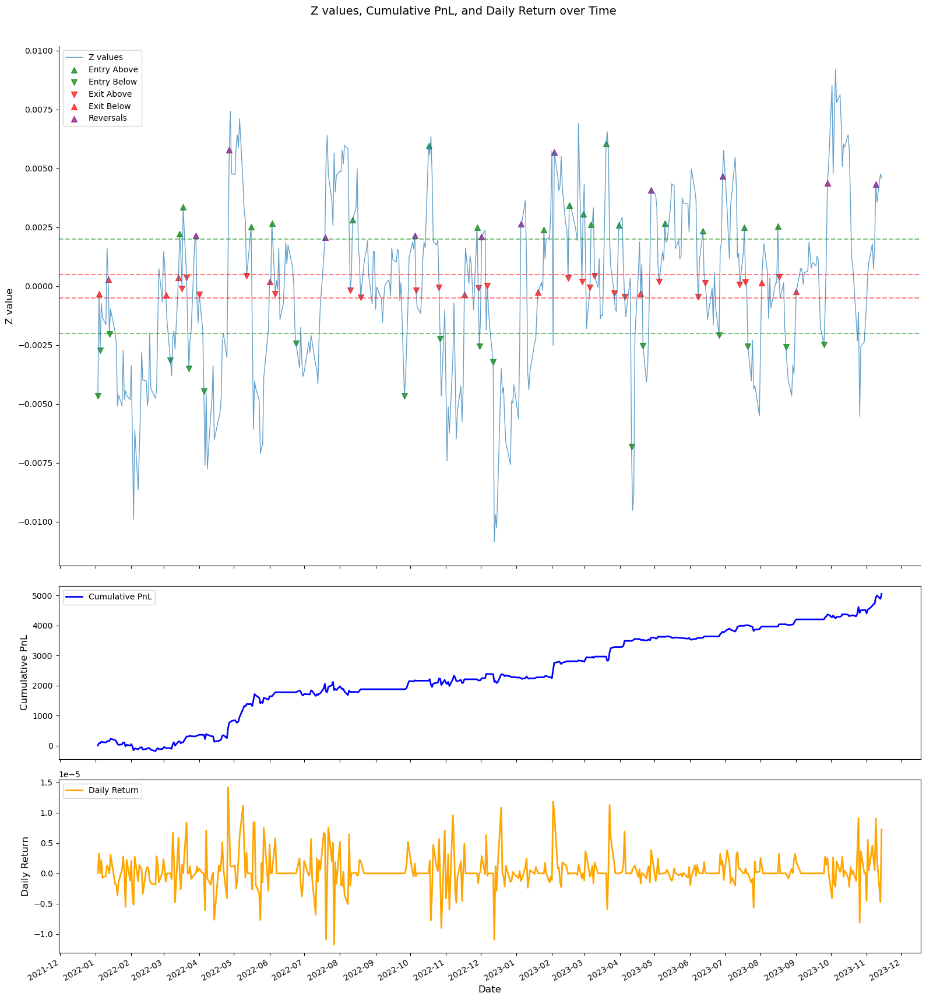

In [70]:

entry_above = data_list[(data_list['Action'] == 1) & (data_list['ending_status'] == 1)].index
entry_below = data_list[(data_list['Action'] == 1) & (data_list['ending_status'] == 2)].index
exit_above = data_list[(data_list['Action'] == 2) & (data_list['starting_status'] == 1)].index
exit_below = data_list[(data_list['Action'] == 2) & (data_list['starting_status'] == 2)].index

status_1 = data_list[(data_list['ending_status'] == 1)].index
status_2 = data_list[ (data_list['ending_status'] == 2)].index
status_3 = data_list[ (data_list['ending_status'] == 3)].index

reverals_high_to_low = data_list[(data_list['starting_status'] == 1) & (data_list['ending_status'] == 2)].index
reverals_low_to_high = data_list[(data_list['starting_status'] == 2) & (data_list['ending_status'] == 1)].index

# Convert Time Return data to a DataFrame for better readability
time_return = first_strategy.analyzers.timereturn.get_analysis()
time_returns_df = pd.DataFrame(list(time_return.items()), columns=['Date', 'Return'])
time_returns_df['Date'] = pd.to_datetime(time_returns_df['Date'])
time_returns_df.set_index('Date', inplace=True)
time_returns_df = time_returns_df[(time_returns_df.index>=pd.to_datetime("2022-01-03")) & (time_returns_df.index<=pd.to_datetime("2023-11-14")) ]


# Create a figure and a set of subplots
fig, axs = plt.subplots(3, 1, figsize=(16, 18), sharex=True, 
                        gridspec_kw={'height_ratios': [3, 1, 1]})

# Plot Z values on the first subplot
axs[0].plot(data_list.index.to_numpy(), data_list['z'].to_numpy(), label='Z values', linewidth=1, alpha=0.7)

# Add horizontal lines with less opacity for Z values
axs[0].axhline(y=0.002, color='g', linestyle='--', alpha=0.5)
axs[0].axhline(y=-0.002, color='g', linestyle='--', alpha=0.5)
axs[0].axhline(y=0.0005, color='r', linestyle='--', alpha=0.5)
axs[0].axhline(y=-0.0005, color='r', linestyle='--', alpha=0.5)

# Mark entry and exit positions
axs[0].scatter(entry_above, data_list.loc[entry_above, 'z'], marker='^', color='g', s=50, alpha=0.7, label='Entry Above')
axs[0].scatter(entry_below, data_list.loc[entry_below, 'z'], marker='v', color='g', s=50, alpha=0.7, label='Entry Below')
axs[0].scatter(exit_above, data_list.loc[exit_above, 'z'], marker='v', color='r', s=50, alpha=0.7, label='Exit Above')
axs[0].scatter(exit_below, data_list.loc[exit_below, 'z'], marker='^', color='r', s=50, alpha=0.7, label='Exit Below')
axs[0].scatter(reverals_low_to_high, data_list.loc[reverals_low_to_high, 'z'], marker='^', color='purple', s=50, alpha=0.7, label='Reversals')


# Set labels for the first subplot
axs[0].set_ylabel('Z value', fontsize=12)
axs[0].legend(loc='upper left')
axs[0].spines['top'].set_visible(False)
axs[0].spines['right'].set_visible(False)

# Plot Cumulative PnL on the second subplot
axs[1].plot(data_list.index.to_numpy(), data_list['Cumulative PnL'].to_numpy(), label='Cumulative PnL', color='blue', linewidth=2)
axs[1].set_xlabel('Date', fontsize=12)
axs[1].set_ylabel('Cumulative PnL', fontsize=12)
axs[1].legend(loc='upper left')

# Third subplot for Time Return
axs[2].plot(time_returns_df.index.to_numpy(), time_returns_df['Return'].to_numpy(), label='Daily Return', color='orange', linewidth=2)
axs[2].set_xlabel('Date', fontsize=12)
axs[2].set_ylabel('Daily Return', fontsize=12)
axs[2].legend(loc='upper left')

# Set the x-axis to display dates in a readable format for all subplots
axs[2].xaxis.set_major_locator(mdates.MonthLocator(interval=1))
axs[2].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))

# Rotate and align the tick labels so they look better
fig.autofmt_xdate()

# Set the title for the entire figure
fig.suptitle('Z values, Cumulative PnL, and Daily Return over Time', fontsize=14)

# Adjust the space between the subplots
plt.subplots_adjust(hspace=0.3)

# Show the plot with a tight layout
plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust the rectangle inscribed by the subplots
plt.show()


We Can see that the Strategy Does Pretty well, generating consistant returns. However there are alot of trades so I suspect that it is over fit to insample values, espcailly since trading costs are disabled.

# Relationship with SVOL

In Order to Examine wether or not the Trading strategy does better in periods of high volatility we examine its correlation to SVOL a volatility tracking index if retruns are correlated between the two there may be a relation.

**Retrieve SVOL Returns**

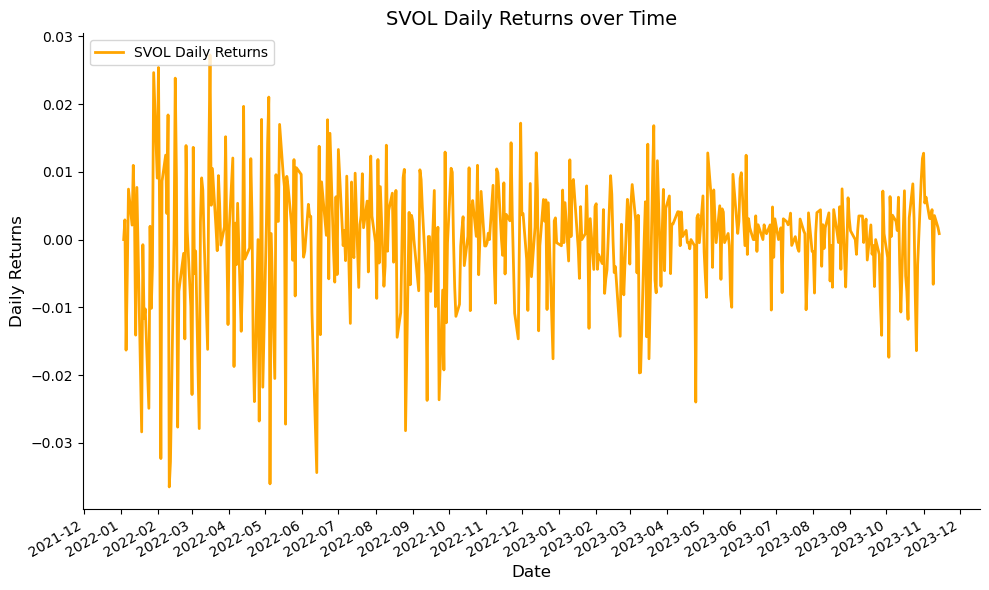

In [71]:
# Filter Svol into only the relevant reading days
ETFS['SVOL'] = ETFS['SVOL'][(ETFS['SVOL'].index>=pd.to_datetime("2022-01-03")) & (ETFS['SVOL'].index<=pd.to_datetime("2023-11-14")) ]

# Calulate daily Returns of SVOL
ETFS['SVOL']['rets'] = ETFS['SVOL']['close'].pct_change()

ETFS['SVOL']['rets'].fillna(0.00, inplace=True)


# Create a figure for the SVOL daily returns
plt.figure(figsize=(10, 6))

# Plot the daily returns of SVOL
plt.plot(ETFS['SVOL'].index.to_numpy(), ETFS['SVOL']['rets'].to_numpy(), label='SVOL Daily Returns', color='orange', linewidth=2)

# Set the x-axis to display dates in a readable format
plt.gca().xaxis.set_major_locator(mdates.MonthLocator(interval=1))
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))

# Rotate and align the tick labels so they look better
plt.gcf().autofmt_xdate()

# Remove top and right frame lines
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Set labels and title
plt.xlabel('Date', fontsize=12)
plt.ylabel('Daily Returns', fontsize=12)
plt.title('SVOL Daily Returns over Time', fontsize=14)

# Add a legend
plt.legend(loc='upper left')

# Show the plot with a tight layout
plt.tight_layout()
plt.show()

Calculate correlation between SVOL daily returns and My Strategies daily returns

In [72]:
# Adding a constant term to the independent variable
X = ETFS['SVOL']['rets']
X = sm.add_constant(X)

Y = time_returns_df['Return']

# Create the OLS model
model = sm.OLS(Y, X)

# Fit the model
results = model.fit()

# Print the summary of the regression
print(results.summary())


                            OLS Regression Results                            
Dep. Variable:                 Return   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     1.475
Date:                Thu, 25 Jan 2024   Prob (F-statistic):              0.225
Time:                        23:01:12   Log-Likelihood:                 5317.0
No. Observations:                 470   AIC:                        -1.063e+04
Df Residuals:                     468   BIC:                        -1.062e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       4.543e-07   1.37e-07      3.324      0.0

There doesnt seem to be a raltionship since the coefficent is so small. Since the probability it is due to chance is 0.000 this is a statistically signifigant relationship.

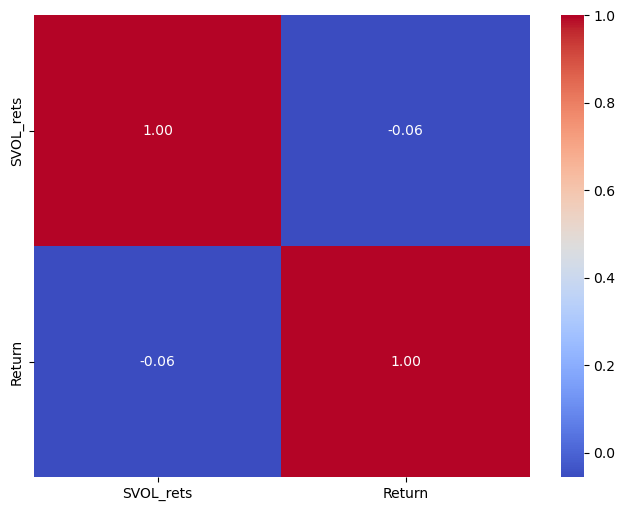

In [73]:
# Creating a new DataFrame with the independent and dependent variables
combined_df = pd.DataFrame()
combined_df['SVOL_rets'] = ETFS['SVOL']['rets']
combined_df['Return'] = time_returns_df['Return']

# Compute the correlation matrix
corr = combined_df.corr()

# Generate a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(corr, annot=True, fmt=".2f", cmap='coolwarm')
plt.show()

Exmaining the corrlations we dont see much differnce. still uncorrlated.

# Relationship with Fama-French Factors

Now lets Decompse our strategies returns with that of the fama french factors to see if our strat is related to these commonly looked at factors.

In [74]:
# Read n daily Fama-French factor returns into pandas data Frame
FF3 = pd.read_csv('F-F_Research_Data_Factors_daily.csv')
display(FF3.tail())

,date,Mkt-RF,SMB,HML,RF
25624,20231124,0.11,0.59,0.19,0.021
25625,20231127,-0.23,-0.11,-0.08,0.021
25626,20231128,0.06,-0.29,0.05,0.021
25627,20231129,0.01,0.44,0.69,0.021
25628,20231130,0.35,-0.45,0.01,0.021


In [75]:
# Convert date column into a datetime object, and set it to the index
FF3['date'] = pd.to_datetime(FF3['date'], format='%Y%m%d')


FF3.set_index(FF3['date'],inplace=True)

FF3 = FF3[(FF3['date']>=pd.to_datetime("2022-01-03")) & (FF3['date'] <= pd.to_datetime("2023-11-14"))]

# Drop the date column so there are no duplicate columns
FF3.drop('date', axis=1, inplace=True)

display(FF3)

,Mkt-RF,SMB,HML,RF
date,,,,
2022-01-03,0.73,0.34,0.78,0.000
2022-01-04,-0.29,-0.82,3.62,0.000
2022-01-05,-2.28,-1.46,2.60,0.000
2022-01-06,0.00,0.20,1.75,0.000
2022-01-07,-0.48,-1.32,2.02,0.000
...,...,...,...,...
2023-11-08,-0.04,-0.82,-0.44,0.021
2023-11-09,-0.89,-1.08,0.49,0.021
2023-11-10,1.49,-0.57,-0.44,0.021


In [76]:
# Adding a constant term to the independent variable
X = FF3
X = sm.add_constant(X)

Y = time_returns_df['Return']

# Create the OLS model
model = sm.OLS(Y, X)

# Fit the model
results = model.fit()

# Print the summary of the regression
print(results.summary())


                            OLS Regression Results                            
Dep. Variable:                 Return   R-squared:                       0.006
Model:                            OLS   Adj. R-squared:                 -0.002
Method:                 Least Squares   F-statistic:                    0.7312
Date:                Thu, 25 Jan 2024   Prob (F-statistic):              0.571
Time:                        23:01:13   Log-Likelihood:                 5317.7
No. Observations:                 470   AIC:                        -1.063e+04
Df Residuals:                     465   BIC:                        -1.060e+04
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       4.236e-07   2.47e-07      1.712      0.0

Not seeing much correlation again which makes sense because our stratgy profits of slippage in correlated instruments, which is a fact completely independent of any of these factors. again the lack of a relationshop is statistically signifigant since prob = 0.000

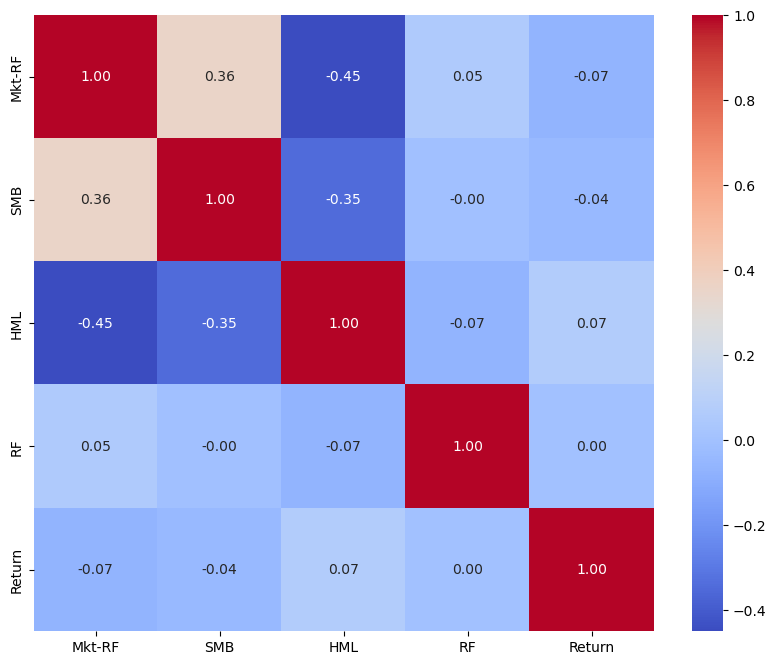

In [77]:
# Combine your independent and dependent variables into a single DataFrame
combined_df = FF3.copy()
combined_df['Return'] = time_returns_df['Return']

# Compute the correlation matrix
corr = combined_df.corr()

# Generate a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr, annot=True, fmt=".2f", cmap='coolwarm')
plt.show()

Here we can see that generally there is low corrlation with my returns but high corrlation between the factors showing the factors might not be that good since they double count the same effects but only marginally.